## DSCC202-402 Data Science at Scale Final Project
### Tracking Tweet sentiment at scale using a pretrained transformer (classifier)
<p>Consider the following illustration of the end to end system that you will be building.  Each student should do their own work.  The project will demonstrate your understanding of Spark Streaming, the medalion data architecture using Delta Lake, Spark Inference at Scale using an MLflow packaged model as well as Exploritory Data Analysis and System Tracking and Monitoring.</p>
<br><br>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/pipeline.drawio.png">

<p>
You will be pulling an updated copy of the course GitHub repositiory: <a href="https://github.com/lpalum/dscc202-402-spring2024">The Repo</a>.  If you are unclear on how to pull an updated copy using the GitHub command line, the following <a href="https://techwritingmatters.com/how-to-update-your-forked-repository-on-github">document</a> is helpful.  Be sure to add the professors and TAs as collaborators on your project. 

- lpalum@gmail.com GitHub ID: lpalum
- ajay.anand@rochester.edu GitHub ID: ajayan12
- divyamunot1999@gmail.com GitHub ID: divyamunot
- ylong6@u.Rochester.edu GitHub ID: NinaLong2077

Once you have updates your fork of the repository you should see the following template project that is resident in the final_project directory.
</p>

<img src="https://data-science-at-scale.s3.amazonaws.com/images/notebooks.drawio.png">

<p>
You can then pull your project into the Databrick Workspace using the <a href="https://www.databricks.training/step-by-step/importing-courseware-from-github/index.html">Repos</a> feature.
Each student is expected to submit the URL of their project on GitHub with their code checked in on the main/master branch.  This illustration highlights the branching scheme that you may use to work on your code in steps and then merge your submission into your master branch before submitting.
</p>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/github.drawio.png">
<p>
Work your way through this notebook which will give you the steps required to submit a complete and compliant project.  The following illustration and associated data dictionary specifies the transformations and data that you are to generate for each step in the medallion pipeline.
</p>
<br><br>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/dataframes.drawio.png">

#### Bronze Data - raw ingest
- date - string in the source json
- user - string in the source json
- text - tweet string in the source json
- sentiment - the given sentiment of the text as determined by an unknown model that is provided in the source json
- source_file - the path of the source json file the this row of data was read from
- processing_time - a timestamp of when you read this row from the source json

#### Silver Data - Bronze Preprocessing
- timestamp - convert date string in the bronze data to a timestamp
- mention - every @username mentioned in the text string in the bronze data gets a row in this silver data table.
- cleaned_text - the bronze text data with the mentions (@username) removed.
- sentiment - the given sentiment that was associated with the text in the bronze table.

#### Gold Data - Silver Table Inference
- timestamp - the timestamp from the silver data table rows
- mention - the mention from the silver data table rows
- cleaned_text - the cleaned_text from the silver data table rows
- sentiment - the given sentiment from the silver data table rows
- predicted_score - score out of 100 from the Hugging Face Sentiment Transformer
- predicted_sentiment - string representation of the sentiment
- sentiment_id - 0 for negative and 1 for postive associated with the given sentiment
- predicted_sentiment_id - 0 for negative and 1 for positive assocaited with the Hugging Face Sentiment Transformer

#### Application Data - Gold Table Aggregation
- min_timestamp - the oldest timestamp on a given mention (@username)
- max_timestamp - the newest timestamp on a given mention (@username)
- mention - the user (@username) that this row pertains to.
- negative - total negative tweets directed at this mention (@username)
- neutral - total neutral tweets directed at this mention (@username)
- positive - total positive tweets directed at this mention (@username)

When you are designing your approach, one of the main decisions that you will need to make is how you are going to orchestrate the streaming data processing in your pipeline.  There are several valid approaches.  First, you may choose to start the bronze_stream and let it complete (read and append all of the source data) before preceeding and starting up the silver_stream.  This approach has latency associated with it but it will allow your code to proceed in a linear fashion and process all the data by the end of your notebook execution.  Another potential approach is to start all the streams and have a "watch" method to determine when the pipeline has processed sufficient or all of the source data before stopping and displaying results.  Both of these approaches are valid and have different implications on how you will trigger your steams and how you will gate the execution of your pipeline.  Think through how you want to proceed and ask questions if you need guidance. The following references may be helpful:
- [Spark Structured Streaming Programming Guide](https://spark.apache.org/docs/latest/structured-streaming-programming-guide.html)
- [Databricks Autoloader - Cloudfiles](https://docs.databricks.com/en/ingestion/auto-loader/index.html)

### Be sure that your project runs end to end when *Run all* is executued on this notebook! (15 Points out of 60)

In [0]:
%run ./includes/includes

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
petastorm 0.11.4 requires pyspark>=2.1.0, which is not installed.


Variable Name,Value,Description
TWEET_BUCKET_NAME,voc-75-databricks-data,AWS S3 Bucket Name where the tweets are coming into your system.
TWEET_BUCKET_URL,https://voc-75-databricks-data.s3.amazonaws.com/,AWS S3 Bucket URL where the tweets are coming into your system.
TWEET_SOURCE_PATH,s3a://voc-75-databricks-data/voc_volume/,AWS S3 Path where the tweets are coming into your system.
USER_DIR,/tmp/labuser104917-3019804/,Path to the local storage (dbfs) for your project.
BRONZE_CHECKPOINT,/tmp/labuser104917-3019804/bronze.checkpoint,Store your Bronze Checkpoint data here.
BRONZE_DELTA,/tmp/labuser104917-3019804/bronze.delta,Store your Bronze Delta Table here.
SILVER_CHECKPOINT,/tmp/labuser104917-3019804/silver.checkpoint,Store your Silver Checkpoint data here.
SILVER_DELTA,/tmp/labuser104917-3019804/silver.delta,Store your Silver Delta Table here.
GOLD_CHECKPOINT,/tmp/labuser104917-3019804/gold.checkpoint,Store your Gold Checkpoint data here.
GOLD_DELTA,/tmp/labuser104917-3019804/gold.delta,Store your Gold Delta Table here.


the includes are included


In [0]:
"""
Adding a widget to the notebook to control the clearing of a previous run.
or stopping the active streams using routines defined in the utilities notebook
"""
dbutils.widgets.removeAll()

dbutils.widgets.dropdown("clear_previous_run", "No", ["No","Yes"])
if (getArgument("clear_previous_run") == "Yes"):
    clear_previous_run()
    print("Cleared all previous data.")

dbutils.widgets.dropdown("stop_streams", "No", ["No","Yes"])
if (getArgument("stop_streams") == "Yes"):
    stop_all_streams()
    print("Stopped all active streams.")

from delta import *
dbutils.widgets.dropdown("optimize_tables", "No", ["No","Yes"])
if (getArgument("optimize_tables") == "Yes"):
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, BRONZE_DELTA).optimize().executeCompaction()
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, SILVER_DELTA).optimize().executeCompaction()
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, GOLD_DELTA).optimize().executeCompaction()
    print("Optimized all of the Delta Tables")

## 1.0 Import your libraries here...
- Are your shuffle partitions consistent with your cluster and your workload?
- Do you have the necessary libraries to perform the required operations in the pipeline/application?

In [0]:
%fs ls "dbfs:/tmp/labuser104917-2387441/"

In [0]:
from pyspark.sql.functions import *
import re
import mlflow
import mlflow.pyfunc
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

In [0]:
# ENTER YOUR CODE HERE
spark.conf.set("spark.sql.legacy.timeParserPolicy","LEGACY")
spark.conf.set("spark.sql.shuffle.partitions", spark.sparkContext.defaultParallelism)
print(spark.conf.get("spark.sql.shuffle.partitions"))

4


## 2.0 Use the utility functions to ...
- Read the source file directory listing
- Count the source files (how many are there?)
- print the contents of one of the files

In [0]:
# %fs ls "s3a://voc-75-databricks-data/voc_volume/"
files = dbutils.fs.ls(TWEET_SOURCE_PATH) #"s3a://voc-75-databricks-data/voc_volume/"
display(files)

path,name,size,modificationTime
s3a://voc-75-databricks-data/voc_volume/0.json,0.json,219,1705254853000
s3a://voc-75-databricks-data/voc_volume/1.json,1.json,213,1705254854000
s3a://voc-75-databricks-data/voc_volume/10.json,10.json,146,1705254854000
s3a://voc-75-databricks-data/voc_volume/100.json,100.json,162,1705254859000
s3a://voc-75-databricks-data/voc_volume/1000.json,1000.json,108,1705254910000
s3a://voc-75-databricks-data/voc_volume/10000.json,10000.json,236,1705255427000
s3a://voc-75-databricks-data/voc_volume/100000.json,100000.json,115,1712346710000
s3a://voc-75-databricks-data/voc_volume/100001.json,100001.json,162,1712346710000
s3a://voc-75-databricks-data/voc_volume/100002.json,100002.json,129,1712346710000
s3a://voc-75-databricks-data/voc_volume/100003.json,100003.json,145,1712346710000


In [0]:
print(len(files))

200001


In [0]:
temp = spark.read.json("s3a://voc-75-databricks-data/voc_volume/100002.json")
display(temp)

date,sentiment,text,user
Tue Apr 21 04:21:58 PDT 2009,positive,My babe's coming over! Yay!,yeahidkmaybe


## 3.0 Transform the Raw Data to Bronze Data using a stream
- define the schema for the raw data
- setup a read stream using cloudfiles and the source data format
- setup a write stream using cloudfiles to append to the bronze delta table
- enforce schema
- allow a new schema to be merged into the bronze delta table
- Use the defined BRONZE_CHECKPOINT and BRONZE_DELTA paths defines in the includes
- name your raw to bronze stream as bronze_stream
- transform the raw data to the bronze data using the data definition at the top of the notebook

In [0]:
# ENTER YOUR CODE HERE
schema = "date STRING, user STRING, text STRING, sentiment STRING"

bronze_stream = (spark.readStream.format("cloudFiles") 
  .option("cloudFiles.format", "json")
  .schema(schema) 
  .load(TWEET_SOURCE_PATH)
  .withColumn("source_file",input_file_name())
  .withColumn("processing_time",current_timestamp()) 
  .writeStream 
  .option("mergeSchema", "true") 
  .option("checkpointLocation", BRONZE_CHECKPOINT)
  .queryName("bronze_stream")
  .option("maxFilesPerTrigger", 500)
  .trigger(processingTime="2 seconds") 
  .start(BRONZE_DELTA)
)

In [0]:
bronze_temp = spark.read.format("delta").load(BRONZE_DELTA)

In [0]:
display(bronze_temp)

date,user,text,sentiment,source_file,processing_time
Sat May 02 06:02:40 PDT 2009,TheLuxPod,"@TextTonic ""control"" or ""abuse""? I see them as Very different. Whilst we are into self promoting here goes http://tinyurl.com/cru3hu",positive,s3a://voc-75-databricks-data/voc_volume/119659.json,2024-05-11T23:34:20.090+0000
Sat May 02 06:02:11 PDT 2009,alternatickers,"I was just checking Google Analytics (which I obsessively do every morning) and saw that 5 people Googled ""alterna tickers not working?""",negative,s3a://voc-75-databricks-data/voc_volume/119596.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:57:11 PDT 2009,focusedfilms,"is having breakfast: oatmeal sprinkled w/cinnamon, nutmeg, & a few drops of maple syrup w/apple wedges on the side, & spring water. YUMMY",positive,s3a://voc-75-databricks-data/voc_volume/119425.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:57:35 PDT 2009,technicalwriter,"I woke up this morning with an article on ""5 Levels of Learning"" fully formed in my mind. I have to write it down before I forget it",positive,s3a://voc-75-databricks-data/voc_volume/119473.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:46:19 PDT 2009,keija,"WHO DOES WORK ON THE RAIL TRACKS ON A BANK HOLIDAY?!?! It's a 2hr extended journey to begin with, now we're being ""held"" & Shout!'s at 3!",negative,s3a://voc-75-databricks-data/voc_volume/119060.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:42:18 PDT 2009,Lucyy_x3,"@ddlovato .ahh, Im scared about swine flu too. its like ""level 5"" or something. don't know what it means though. haha. England loves youu",positive,s3a://voc-75-databricks-data/voc_volume/118956.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:42:21 PDT 2009,witty_twit_brit,"iam up following celebs...as stalker-ish as that sounds lol...positive out comes from my ""search"" tho!p i think its really them",positive,s3a://voc-75-databricks-data/voc_volume/118964.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:47:06 PDT 2009,Squemma,@hlsidle. Did you go on it!? I went on it in November & tried to do the tune tom hanks did in the film! Oh & stood next to Russell brand,positive,s3a://voc-75-databricks-data/voc_volume/119081.json,2024-05-11T23:34:20.090+0000
Sat May 02 05:57:25 PDT 2009,IWannaBreakOut,"Homework; art-ing pears. sex and the city full screen on the computer. Hanging with friends tonight, then to the club with another friend",positive,s3a://voc-75-databricks-data/voc_volume/119457.json,2024-05-11T23:34:20.090+0000
Tue Apr 07 04:27:15 PDT 2009,aimingelsewhere,Bah! Just found out we didn't win a pitch because the client felt the team didn't click. What are you sayin? We're not cool enough? Sad.,negative,s3a://voc-75-databricks-data/voc_volume/11954.json,2024-05-11T23:34:20.090+0000


## 4.0 Bronze Data Exploratory Data Analysis
- How many tweets are captured in your Bronze Table?
- Are there any columns that contain Nan or Null values?  If so how many and what will you do in your silver transforms to address this?
- Count the number of tweets by each unique user handle and sort the data by descending count.
- How many tweets have at least one mention (@) how many tweet have no mentions (@)
- Plot a bar chart that shows the top 20 tweeters (users)


In [0]:
# Number of Tweets
display(f"Number of tweets in bronze table: {bronze_temp.count()}")

'Number of tweets in bronze table: 200000'

In [0]:
# Handling null values
display(f"Number of null values in bronze table: {bronze_temp.count()-bronze_temp.na.drop().count()}")

'Number of null values in bronze table: 0'

There are no null values in any of the columns of the bronze table.

In [0]:
# Count and Sort Unique user tweets
sorted_bronze_temp = bronze_temp.groupBy("user").agg(count("text").alias("Number of Tweets")).sort(col("Number of Tweets").desc())
display(sorted_bronze_temp)

user,Number of Tweets
tweetpet,310
nuttychris,129
iHomeTech,81
tsarnick,77
Hollywood_Trey,71
divxdownloads,68
lesley007,65
redrobinrockn,58
MissxMarisa,57
SarahSaner,56


In [0]:
# Tweets with mentions
mention_bronze_temp = bronze_temp.filter(col("text").contains("@"))
display(f"Number of Tweets containing @: {mention_bronze_temp.count()}")

'Number of Tweets containing @: 93817'

In [0]:
# Tweets with no mentions
display(f"Number of Tweets not containing @: {bronze_temp.count()-mention_bronze_temp.count()}")

'Number of Tweets not containing @: 106183'

In [0]:
# Bar plot of top 20 tweeters
display(sorted_bronze_temp.limit(20))

user,Number of Tweets
tweetpet,310
nuttychris,129
iHomeTech,81
tsarnick,77
Hollywood_Trey,71
divxdownloads,68
lesley007,65
redrobinrockn,58
MissxMarisa,57
SarahSaner,56


Databricks visualization. Run in Databricks to view.

## 5.0 Transform the Bronze Data to Silver Data using a stream
- setup a read stream on your bronze delta table
- setup a write stream to append to the silver delta table
- Use the defined SILVER_CHECKPOINT and SILVER_DELTA paths in the includes
- name your bronze to silver stream as silver_stream
- transform the bronze data to the silver data using the data definition at the top of the notebook

In [0]:
@pandas_udf(ArrayType(StringType()))
def extract_mention_udf(text_array: pd.Series) -> pd.Series:
    return text_array.apply(lambda text: re.findall(r"@\w+",text))
    # mentions = []
    # for word in text.str.split():
    #     if (word.startswith("@")) and (len(word) > 1):
    #         if word not in mentions:
    #             mentions.append(word)
    # return mentions

# extract_mention_udf = udf(extract_mentions, ArrayType(StringType()))

In [0]:
bronze_df = (spark.readStream
  .format("delta") 
  .load(BRONZE_DELTA)
)
filtered_bronze = (bronze_df.filter(col("text").contains("@"))
                            .withColumn("mentions",extract_mention_udf(col("text")))
                            .withColumn("mention",explode(col("mentions")))
                            .withColumn("cleaned_text", trim(regexp_replace(col("text"), r"@\w+", "")))
                            .select(to_timestamp(col("date"),"EEE MMM dd HH:mm:ss z yyyy").alias("timestamp"),
                                                 col("mention"),col("cleaned_text"),col("sentiment").alias("Sentiment"))
                            .distinct()
)
silver_stream = (filtered_bronze.writeStream
                                .outputMode("append")
                                .format("delta")
                                .queryName("silver_stream")
                                # .trigger(processingTime="1 second")
                                .option("checkpointLocation", SILVER_CHECKPOINT)
                                .start(SILVER_DELTA)
)

## 6.0 Transform the Silver Data to Gold Data using a stream
- setup a read stream on your silver delta table
- setup a write stream to append to the gold delta table
- Use the defined GOLD_CHECKPOINT and GOLD_DELTA paths defines in the includes
- name your silver to gold stream as gold_stream
- transform the silver data to the gold data using the data definition at the top of the notebook
- Load the pretrained transformer sentiment classifier from the MODEL_NAME at the production level from the MLflow registry
- Use a spark UDF to parallelize the inference across your silver data

In [0]:
# ENTER YOUR CODE HERE
silver_temp = spark.read.format("delta").load(SILVER_DELTA)

In [0]:
display(silver_temp)

timestamp,mention,cleaned_text,Sentiment
2009-05-02T12:52:16.000+0000,@eksentrik,"Are you sure? Gah I'm really embarrassed now >.< If so, big thanks! Um.. it's Watashi ni xx Shinasai and Arisa? Again, thanks!",positive
2009-05-02T10:16:59.000+0000,@PaulQT_Ran,awww saw 's chi vi at the usual 1st & 3rd friday spot along with aka BABY PAUL!!! now i'm randomly wide awake!,negative
2009-05-02T10:21:29.000+0000,@JonathanRKnight,"I'm going out with My Kids this afternoon. It's a lovely sunny day,The countryside on My doorstep Hope You're asleep? xx",positive
2009-05-02T10:00:19.000+0000,@R2ThaEdgy,"This guy came up to my friend for money, then asked her for a cigarette... Maybe its best you dont give so you cant give more.",negative
2009-05-02T10:06:38.000+0000,@amykate,"being a geek, when i need to label things, i use my dymo labelwriter...... i fall into the catagory of ""sad"" apparently",positive
2009-05-02T10:21:15.000+0000,@rustyrockets,Its going to be EPIC rusty! We're gonna be there too. So close the sweat will drench us probably! Ewww & Hurrah equally. x,positive
2009-05-02T09:56:09.000+0000,@Jbitchproject,"My boyfriend came to visit me. Just chilled. watched DVDs, ate, chat, played cards. I was sick, that's why he came by.",positive
2009-05-02T07:11:11.000+0000,@ryanm07,AND thx 4 follows frm and of crse Hope I'm cool as you think!,positive
2009-04-07T10:54:10.000+0000,@MissSmashlee,"oh not alot, uni, working, same as just about everyone. handed in the first assignment in over a year on friday, was crazy",positive
2009-05-02T07:26:11.000+0000,@blissapp,"I phoned up and checked. The rate I'm getting for 5 months is too close to my old annual rate, but it's all confirmed now",positive


In [0]:
# @pandas_udf("string","double")
# def predict(text_array: pd.Series) -> pd.DataFrame:
#     model = mlflow.pyfunc.load_model(f"models:/{MODEL_NAME}/production")
#     pred = model.predict(text_array)
#     labels = [pred["label"] for pred in predictions]
#     scores = [pred["score"] for pred in predictions]
#     return pd.DataFrame({"label":labels, "score":scores})
model_name = f"models:/{MODEL_NAME}/production"
predict = mlflow.pyfunc.spark_udf(spark,model_uri=model_name)

/local_disk0/.ephemeral_nfs/envs/pythonEnv-bb7bd013-295a-4359-8f32-4f68f2427bdb/lib/python3.9/site-packages/mlflow/store/artifact/utils/models.py:32: FutureWarning: ``mlflow.tracking.client.MlflowClient.get_latest_versions`` is deprecated since 2.9.0. Model registry stages will be removed in a future major release. To learn more about the deprecation of model registry stages, see our migration guide here: https://mlflow.org/docs/2.12.2/model-registry.html#migrating-from-stages
  latest = client.get_latest_versions(name, None if stage is None else [stage])


2024/05/12 00:25:21 INFO mlflow.store.artifact.artifact_repo: The progress bar can be disabled by setting the environment variable MLFLOW_ENABLE_ARTIFACTS_PROGRESS_BAR to false
2024/05/12 00:25:25 WARNING mlflow.utils.requirements_utils: Detected one or more mismatches between the model's dependencies and the current Python environment:
 - mlflow (current: 2.12.2, required: mlflow==2.11.3)
To fix the mismatches, call `mlflow.pyfunc.get_model_dependencies(model_uri)` to fetch the model's environment and install dependencies using the resulting environment file.
2024/05/12 00:25:25 WARNING mlflow.pyfunc: Calling `spark_udf()` with `env_manager="local"` does not recreate the same environment that was used during training, which may lead to errors or inaccurate predictions. We recommend specifying `env_manager="conda"`, which automatically recreates the environment that was used to train the model and performs inference in the recreated environment.


2024/05/12 00:25:26 INFO mlflow.models.flavor_backend_registry: Selected backend for flavor 'python_function'


In [0]:
silver_df = (spark.readStream
  .format("delta") 
  .load(SILVER_DELTA)
)
filtered_silver = (silver_df.withColumn("prediction", predict(col("cleaned_text")))
                            .withColumn("Predicted_sentiment", col("prediction.label"))
                            .withColumn("predicted_score", (100*col("prediction.score")))
                            .withColumn("predicted_sentiment_id", when(col("Predicted_sentiment") == "POS", 1).otherwise(0))
                            .withColumn("sentiment_id", when(col("sentiment") == "positive", 1).otherwise(0))
                            .select("timestamp", "mention", "cleaned_text", "sentiment", "predicted_score", "Predicted_sentiment", "sentiment_id", "predicted_sentiment_id")
)
gold_stream = (filtered_silver.writeStream
                                .outputMode("append")
                                .format("delta")
                                .queryName("gold_stream")
                                .option("maxFilesPerTrigger", 100)
                                .trigger(processingTime="10 seconds") 
                                .option("checkpointLocation", GOLD_CHECKPOINT)
                                .start(GOLD_DELTA)
)

In [0]:
gold_temp = spark.read.format("delta").load(GOLD_DELTA)

In [0]:
display(gold_temp)

timestamp,mention,cleaned_text,sentiment,predicted_score,Predicted_sentiment,sentiment_id,predicted_sentiment_id
2009-05-04T05:56:52.000+0000,@ableandgame,"Oh, thankyou so much! Glad you like it! Its a bit of everything, more than TV, a bit of beauty, a bit of movies..",positive,99.2755115032196,POS,1,1
2009-05-04T05:56:59.000+0000,@guyoseary,did ou guys see this? http://i10.photobucket.com/albums/a133/fabriciovercosa/Madonna50ANOS.jpg I think it's awesome!,positive,98.97247552871704,POS,1,1
2009-04-07T13:53:09.000+0000,@danieldennis,I hate it when people say Rocky 5 was horrible. That's my favorite Rocky film. Just for the street fighting...,negative,94.5787787437439,NEG,0,0
2009-05-04T05:50:57.000+0000,@lilivonshtupp,I love that about you though. I still need to see this fantastic hair of yours. That's how long its been,negative,99.186110496521,POS,0,1
2009-05-04T13:54:09.000+0000,@pchaganti,"concur with http://tr.im/kmVl, but people can't wait. Don't stop making VAS. When clouds become a commodity, do ""cross-cloud""",positive,81.96648359298706,POS,1,1
2009-05-04T13:44:04.000+0000,@MrEricPiRaTe,"You're being sooo ambiguous, no clue re:what's up? Must send me details! Oh, & I'll be on tom re:the Greek & tea tweet-ups!",positive,54.06894087791443,NEU,1,0
2009-05-04T13:49:23.000+0000,@marcmawhinney,We've never heard anyone say they like doing ANYTHING on Monday mornings! You must have had an early cup of coffee or two,positive,70.10190486907959,NEU,1,0
2009-05-04T13:48:59.000+0000,@MySurveyExpert,Hi Jeanne! I host a community dedicated to helping professional women balance their careers with the REST of their life.,positive,92.88906455039978,POS,1,1
2009-05-04T13:48:10.000+0000,@Silveysurfer,they also removed the family photos & story from the menu. I loved that part! Still WAY better than Knoxville Italian.,negative,97.91939854621887,POS,0,1
2009-05-04T13:54:13.000+0000,@DamienCripps,"Awesome Such a shame though Mark who was the Fiddle player died last month, Fab Version of Good Riddance (i have the album)",positive,71.4692771434784,POS,1,1


## 7.0 Capture the accuracy metrics from the gold table in MLflow
Store the following in an MLflow experiment run:
- Store the precision, recall, and F1-score as MLflow metrics
- Store an image of the confusion matrix as an MLflow artifact
- Store the mdoel name and the MLflow version that was used as an MLflow parameters
- Store the version of the Delta Table (input-silver) as an MLflow parameter

In [0]:
# ENTER YOUR CODE HERE
true_sentiment = gold_temp.select("sentiment_id").rdd.flatMap(lambda x: x).collect()
pred_sentiment = gold_temp.select("predicted_sentiment_id").rdd.flatMap(lambda x: x).collect()
precision = precision_score(true_sentiment, pred_sentiment)
recall = recall_score(true_sentiment, pred_sentiment)
f1_score = f1_score(true_sentiment, pred_sentiment)
conf_matrix = confusion_matrix(true_sentiment, pred_sentiment)


In [0]:
from delta.tables import DeltaTable
silver_table = DeltaTable.forPath(spark,SILVER_DELTA)
silver_version = silver_table.history().select("version").limit(1).collect()[0][0]
silver_version_str = str(silver_version)

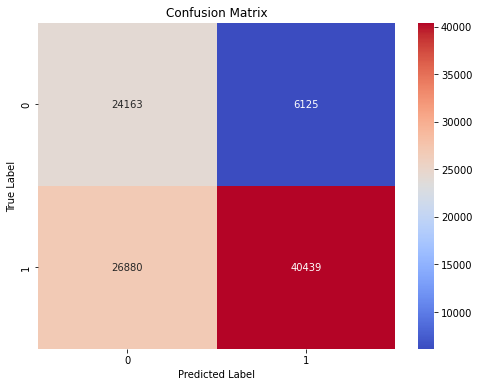

<Figure size 432x288 with 0 Axes>

In [0]:
with mlflow.start_run(run_name="sentiment-analysis") as run:
    mlflow.log_metric("Precision", precision)
    mlflow.log_metric("Recall", recall)
    mlflow.log_metric("F1-score", f1_score)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="coolwarm")
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()
    image_path = "confusion_matrix.png"
    plt.savefig(image_path)
    mlflow.log_artifact(image_path, artifact_path="confusion_matrix_plots")
    mlflow.log_param("Model_name", MODEL_NAME)
    mlflow.log_param("Mlflow_version", mlflow.__version__)
    mlflow.log_param("Input_delta_table_version", silver_version_str)

In [0]:
print(precision, recall, f1_score)

0.8684606133493686 0.6007070812103567 0.7101850144446493


## 8.0 Application Data Processing and Visualization
- How many mentions are there in the gold data total?
- Count the number of neutral, positive and negative tweets for each mention in new columns
- Capture the total for each mention in a new column
- Sort the mention count totals in descending order
- Plot a bar chart of the top 20 mentions with positive sentiment (the people who are in favor)
- Plot a bar chart of the top 20 mentions with negative sentiment (the people who are the vilians)

You may want to use the "Loop Application" widget to control whether you repeateded display the latest plots while the data comes in from your streams before moving on to the next section and cleaning up your run.

*note: A mention is a specific twitter user that has been "mentioned" in a tweet with an @user reference.

In [0]:
# Number of mentions in gold data
display(gold_temp.select(countDistinct("mention").alias("Number of mentions")))

Number of mentions
64828


In [0]:
# Count the number of different sentiment tweets for each mention
sentiment_count_df = (gold_temp.groupBy("mention").agg(sum(when(col("Predicted_sentiment") == "POS", 1).otherwise(0)).alias("positive"),
                                                      sum(when(col("Predicted_sentiment") == "NEG", 1).otherwise(0)).alias("negative"),
                                                      sum(when(col("Predicted_sentiment") == "NEU", 1).otherwise(0)).alias("neutral"))
)
display(sentiment_count_df)

mention,positive,negative,neutral
@ableandgame,2,0,0
@lilivonshtupp,2,0,0
@MrsGrapevine,0,0,1
@ronniebiccard,1,0,0
@TopicTurtle,1,0,0
@icyisabel,1,0,0
@caitlindean,1,0,0
@matt_the_great,1,0,0
@madinalake,6,3,4
@EdEntrepreneur,2,1,0


In [0]:
# Total for each mention
mention_count_df = gold_temp.groupBy("mention").agg(count("*").alias("total"))
display(mention_count_df)

mention,total
@ableandgame,2
@lilivonshtupp,2
@MrsGrapevine,1
@ronniebiccard,1
@TopicTurtle,1
@icyisabel,1
@caitlindean,1
@matt_the_great,1
@madinalake,13
@EdEntrepreneur,3


In [0]:

display(mention_count_df.sort(col("total").desc()))

mention,total
@mileycyrus,605
@tommcfly,443
@ddlovato,432
@JonathanRKnight,244
@taylorswift13,159
@DavidArchie,150
@aplusk,148
@dougiemcfly,142
@stephenfry,141
@DonnieWahlberg,140


In [0]:
display(sentiment_count_df.sort(col("positive").desc()).limit(20).select("mention","positive"))

mention,positive
@mileycyrus,416
@ddlovato,290
@tommcfly,286
@JonathanRKnight,149
@taylorswift13,119
@DavidArchie,99
@selenagomez,93
@Jonasbrothers,90
@DonnieWahlberg,84
@dannywood,80


Databricks visualization. Run in Databricks to view.

In [0]:
display(sentiment_count_df.sort(col("negative").desc()).limit(20).select("mention","negative"))

mention,negative
@mileycyrus,76
@tommcfly,49
@ddlovato,45
@stephenfry,38
@jordanknight,38
@JonathanRKnight,34
@petewentz,32
@JoelMadden,28
@aplusk,27
@dougiemcfly,27


Databricks visualization. Run in Databricks to view.

In [0]:
application_df = (gold_temp.groupBy("mention").agg(sum(when(col("Predicted_sentiment") == "POS", 1).otherwise(0)).alias("positive"),
                                                   sum(when(col("Predicted_sentiment") == "NEG", 1).otherwise(0)).alias("negative"),
                                                   sum(when(col("Predicted_sentiment") == "NEU", 1).otherwise(0)).alias("neutral"),
                                                   count("*").alias("total"),
                                                   min(col("timestamp")).alias("min_timestamp"),
                                                   max(col("timestamp")).alias("Max_timestamp"))
)
display(application_df)

mention,positive,negative,neutral,total,min_timestamp,Max_timestamp
@ableandgame,2,0,0,2,2009-04-21T07:46:02.000+0000,2009-05-04T05:56:52.000+0000
@lilivonshtupp,2,0,0,2,2009-05-04T03:36:20.000+0000,2009-05-04T05:50:57.000+0000
@MrsGrapevine,0,0,1,1,2009-05-04T04:26:52.000+0000,2009-05-04T04:26:52.000+0000
@ronniebiccard,1,0,0,1,2009-05-04T06:57:22.000+0000,2009-05-04T06:57:22.000+0000
@TopicTurtle,1,0,0,1,2009-05-04T06:57:22.000+0000,2009-05-04T06:57:22.000+0000
@icyisabel,1,0,0,1,2009-05-04T00:03:58.000+0000,2009-05-04T00:03:58.000+0000
@caitlindean,1,0,0,1,2009-04-07T06:07:49.000+0000,2009-04-07T06:07:49.000+0000
@matt_the_great,1,0,0,1,2009-04-07T06:13:16.000+0000,2009-04-07T06:13:16.000+0000
@madinalake,6,3,4,13,2009-04-18T15:06:22.000+0000,2009-05-04T13:13:31.000+0000
@EdEntrepreneur,2,1,0,3,2009-04-07T14:24:59.000+0000,2009-05-04T02:01:07.000+0000


## 9.0 Clean up and completion of your pipeline
- using the utilities what streams are running? If any.
- Stop all active streams
- print out the elapsed time of your notebook.

In [0]:
# ENTER YOUR CODE HERE
active_streams = spark.streams.active
if active_streams:
    print("Active Streams:")
    for stream in active_streams:
        print(stream.name)
        stream.stop()
else:
    print("No active streams.")

Active Streams:
bronze_stream
gold_stream
silver_stream


In [0]:
# Get the notebooks ending time note START_TIME was established in the include file when the notebook started.
END_TIME = time.time()
display(END_TIME-START_TIME)

10599.431923866272

## 10.0 How Optimized is your Spark Application (Grad Students Only)
Graduate students (registered for the DSCC-402 section of the course) are required to do this section.  This is a written analysis using the Spark UI (link to screen shots) that support your analysis of your pipelines execution and what is driving its performance.
Recall that Spark Optimization has 5 significant dimensions of considertation:
- Spill: write to executor disk due to lack of memory
- Skew: imbalance in partition size
- Shuffle: network io moving data between executors (wide transforms)
- Storage: inefficiency due to disk storage format (small files, location)
- Serialization: distribution of code segments across the cluster

Comment on each of the dimentions of performance and how your impelementation is or is not being affected.  Use specific information in the Spark UI to support your description.  

Note: you can take sreenshots of the Spark UI from your project runs in databricks and then link to those pictures by storing them as a publicly accessible file on your cloud drive (google, one drive, etc.)

References:
- [Spark UI Reference Reference](https://spark.apache.org/docs/latest/web-ui.html#web-ui)
- [Spark UI Simulator](https://www.databricks.training/spark-ui-simulator/index.html)

### ENTER YOUR MARKDOWN HERE

**Note**: I have selected the distinct rows in the silver table as I have though that having mentions which have same username from the same tweet would be a redundant and contribute to nothing. This is the reason you may see very slight difference in the numbers for Part 8 but the pattern remains same. 

**[Spill](https://drive.google.com/drive/folders/1qltBNOQchhYJ_0qiSx-QoGJUcVSK4Yfz?usp=sharing)**: No spill is happening in this notebook as I have checked the metrics for all of the tasks. I have learnt from Professor Ajay Anand that the spill metrics like Spill(Memory) and Spill(Disk) won't be visible unless spill is happening and that's the case here. Also, we can see that there is no skew in the tasks which would have been the possible reason for spill. The reason for this would be that the cluster memory is sufficient to process all the tasks and there is no need for the executor to write things to disk. Also, all the files have uniform records (1) which was also a reason for no spill (no uneven reads or writes).  
**[Skew](https://drive.google.com/drive/folders/12gAKqtMDJmBwg1lNVo5UaEvvMrdevmAe?usp=sharing)**: We can see from the pictures that read and write sizes for different percentiles are almost uniform indicating very less to no skew in the implementation. The reason for this could be that we didn't encounter any files with unevenly distributed records so there is no skew. Also, as Adaptive Query Engine is enabled by default, we can be ensured that there will no skew in the implementation as it dynamically repartitions data to mitigate it.  
**[Shuffle](https://drive.google.com/drive/folders/1kTOVvQESkZqgNcqDn96aj9SEkqkziSjp?usp=sharing)**: We can see from the pictures that the shuffle across the partitions is not too much even when we have used wide transformations like sort. The reason for this would be that we have set the number of partitions to be a multiple of number of cores available for the cluster which decreases the time and effort for data shuffling across the partitions.  
**[Storage](https://drive.google.com/drive/folders/10pzcDwa3lzq98MyHKgnvykNalgTul4na?usp=sharing)**: In the source directory, we have each record stored in a single file which is poor organization of storage and could lead to tiny files problem. But we can see that there are no storage issues in the implementation. This is because, as we have Delta Lakes compatible with Spark and we are writing to delta tables, these issues will get mitigated by storing uniform amount of records in each parquet file for the delta table.  
**[Serialization](https://drive.google.com/drive/folders/1JnP6D0bpKUzdsML86mgRDPcc4uVE8sYo?usp=sharing)**: There maybe small serialization issues going on as in the implementation there is a udf defined which uses a function from an imported module. But, I have mitigated most of that issue by using pandas udf which uses vectorization to reduce the computational overhead. Also, there is a spark built-in udf to parallelize the inference from the model which won't cause much of serialization issues.  